<a href="https://colab.research.google.com/github/verpeutlab/SLEAPing-with-cockroaches/blob/main/7_Roach_Analysis_Colab.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

This code analyzes pose tracking files from your google drive. This code also visualizes your findings!

Section 1 prepares the google drive

Section 2 generates inference .h5 analysis files

Section 3 loads and prepares your .h5 files

Section 4 visualizes your predictions and gathers data

Section 5 generates figures/stats from your data.

We'll use predictions of pose tracks exported from SLEAP. We'll work with an [Analysis HDF5](https://sleap.ai/tutorials/analysis.html) file (rather than the `.slp` predictions file). This HDF5 file can be exported from SLEAP. It is advised to build your post-SLEAP analysis pipeline around these HDF5 files rather than trying to work directly with the `.slp` files used by SLEAP.

**Note**: You can work with these HDF5 directly in Python (as we'll do here) or MATLAB without having SLEAP itself installed.

*If you need to generate h5 file predictions, please use this Colab to generate predictions in the form of h5 files.*

# **1.** Prep Google Drive

Allow Google Colab to access your drive to access files. We also import necessary python libraries for statistical analysis and generating figures.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

import h5py
import numpy as np
import os
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
from google.colab import files

from gspread_dataframe import get_as_dataframe
from matplotlib.pyplot import figure
!pip install pingouin
import pingouin as pg
import pandas as pd
from scipy.stats import kruskal
from scipy.stats import mannwhitneyu
from scipy.spatial import distance
from scipy.ndimage.filters import gaussian_filter
import matplotlib.cm as cm
from scipy import stats as st
import statsmodels.api as sm
from statsmodels.formula.api import ols
from statsmodels.stats.anova import AnovaRM
from statsmodels.formula.api import mixedlm
from pingouin import mixed_anova, read_dataset, rm_anova
from scipy import stats
from scipy.stats import levene
from scipy.stats import ttest_rel
from scipy.stats import wilcoxon

plt.style.use('seaborn-whitegrid')

Mounted at /content/drive
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 198.9/198.9 kB 3.5 MB/s eta 0:00:00


<ipython-input-1-853f0038983b>:20: DeprecationWarning: Please use `gaussian_filter` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  from scipy.ndimage.filters import gaussian_filter
<ipython-input-1-853f0038983b>:33: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-whitegrid')


# **2.** Generate Inferences

We will generate HDF5 (.h5 file format) inferences from videos located in your drive. To do this, we need to have a model already trained. Place this model file in the same folder as the videos you want to analyze. Otherwise, this code will not know where to "look" for your model.

You can find the pathway by clicking the folder icon on the left panel, looking for your file, clicking the three dots next to the file (or right click), and click "copy pathway".

In [ ]:
#Install necessary packages
!pip uninstall -qqq -y opencv-python opencv-contrib-python
!pip install -qqq "sleap[pypi]>=1.3.3"
import os
os.chdir("/content/drive/SLEAP Starter Kit/5_Trained_models") # Change this file pathway to your google drive

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 5.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 904.1/904.1 kB 40.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.2/88.2 kB 10.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 135.4/135.4 kB 15.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.6/60.6 kB 7.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.8/16.8 MB 52.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.5/60.5 MB 9.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 86.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 228.9/228.9 kB 30.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.5/93.5 kB 13.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 214.3/214.3 kB 26.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━

## Generate Inference
We'll need a video for which we want predictions. Copy the video onto your Google drive and change the file name below to the name of your video.

You can now start tracking. You can change the number of frames to be tracked, or run on the whole video by removing that line. If you are tracking multiple animals, alter the instance_count number


In [ ]:
!sleap-track <file>.mp4 \
  --frames 0-3200 \ # Remove this line of code to track entire video
  --tracking.tracker simple \
  --tracking.clean_instance_count 1\
  -m models/centered_instance \
  -m models/centroid \
  | sleap-convert --format analysis

# —————————— Example ——————————
# !sleap-track 2_SampleVideo.mp4 \
#   --frames 0-3200 \ # Remove this line of code to track entire video
#   --tracking.tracker simple \
#   --tracking.clean_instance_count 1 \
#   -m 230721_111933.centered_instance.n=387 \
#   -m 230721_104153.centroid.n=387 \
#   -o sleap_track_output.slp
# —————————————————————————————

# Run sleap-convert on the saved output file
!sleap-convert sleap_track_output.slp --format analysis


/bin/bash: line 1: sleap-track: command not found
/bin/bash: line 1: sleap-convert: command not found


# **2.** Loading Inferences

Here we are loading the inference file you want to visualize. We can set the path and filename to the analysis HDF5 from your google drive.

We use the [h5py](https://www.h5py.org) package to load data from the HDF5. This is already installed in Colab. If you're running analysis code on your local machine and have SLEAP installed, then `h5py` and other packages we use are already installed in your SLEAP conda environment.


In [ ]:
file = (r'/content/drive/SLEAP Starter Kit/6_Sample_h5_file.h5') # Change this to your pathway

with h5py.File(file, "r") as f:
    occupancy_matrix = f['track_occupancy'][:]
    tracks_matrix = f['tracks'][:]
    track_names = f['track_names'][:]
    edge_name = f['edge_names'][:]

print(occupancy_matrix.shape)
print(tracks_matrix.shape)

# Generate basic data of the HDF5 file
filename = file
with h5py.File(filename, "r") as f:
    dset_names = list(f.keys())
    locations = f["tracks"][:].T
    node_names = [n.decode() for n in f["node_names"][:]]

print("===filename===")
print(filename)
print()

print("===HDF5 datasets===")
print(dset_names)
print()

print("===locations data shape===")
print(locations.shape)
print()

print("===nodes===")
for i, name in enumerate(node_names):
    print(f"{i}: {name}")
print()

print("===edges===")
for i, name in enumerate(edge_name):
    print(f"{i}: {name}")
print()


(3597, 1)
(1, 2, 27, 3597)
===filename===
/content/drive/Shareddrives/Verpeut_Lab/Vincent Truong/Cockroach/models/D2_0_1.mp4.predictions.h5

===HDF5 datasets===
['edge_inds', 'edge_names', 'instance_scores', 'labels_path', 'node_names', 'point_scores', 'provenance', 'track_names', 'track_occupancy', 'tracking_scores', 'tracks', 'video_ind', 'video_path']

===locations data shape===
(3597, 27, 2, 1)

===nodes===
0: Head
1: Metathorax
2: Anus
3: RFleg
4: LFleg
5: RHleg
6: LHleg
7: RAntenna_tip
8: LAntenna_tip
9: LMleg
10: RHleg_joint
11: LHleg_joint
12: Abdomen
13: RMleg_joint
14: LMleg_joint
15: RAntenna_base
16: LAntenna_base
17: Prothorax
18: LFleg_joint
19: RFleg_joint
20: RMLeg
21: RAntenna_mid
22: LAntenna_mid
23: RPalp_base
24: LPalp_base
25: RPalp_tip
26: LPalp_tip

===edges===
0: [b'Metathorax' b'Abdomen']
1: [b'Abdomen' b'Anus']
2: [b'Metathorax' b'RMleg_joint']
3: [b'Metathorax' b'LMleg_joint']
4: [b'LMleg_joint' b'LMleg']
5: [b'Abdomen' b'RHleg_joint']
6: [b'Abdomen' b'LHleg_

In our example file, the shape of the locations matrix (the `tracks` dataset) is (3597, 27, 2, 1) **after it is transposed** (with the `.T`). We transpose the data when loading it in Python; no transpose is needed when using MATLAB. This is because Python and MATLAB expect matrices to be stored differently.

Here's what each dimension of the matrix means:

- 3597: the number of frames;

- 27: the number of nodes in the skeleton (we've also loaded and displayed the `node_names` dataset with the names of these 13 nodes);

- 2: for the x and y coordinates;

- 1: the number of distinct animal identities which were found

We can get these counts from the shape of the matrix, like so:


In [ ]:
frame_count, node_count, _, instance_count = locations.shape

print("frame count:", frame_count)
print("node count:", node_count)
print("instance count:", instance_count)

frame count: 3597
node count: 27
instance count: 1


Format h5 file and fill in missing track values

In [ ]:
from scipy.interpolate import interp1d

def fill_missing(Y, kind="linear"):
    """Fills missing values independently along each dimension after the first."""

    # Store initial shape.
    initial_shape = Y.shape

    # Flatten after first dim.
    Y = Y.reshape((initial_shape[0], -1))

    # Interpolate along each slice.
    for i in range(Y.shape[-1]):
        y = Y[:, i]

        # Build interpolant.
        x = np.flatnonzero(~np.isnan(y))
        f = interp1d(x, y[x], kind=kind, fill_value=np.nan, bounds_error=False)

        # Fill missing
        xq = np.flatnonzero(np.isnan(y))
        y[xq] = f(xq)

        # Fill leading or trailing NaNs with the nearest non-NaN values
        mask = np.isnan(y)
        y[mask] = np.interp(np.flatnonzero(mask), np.flatnonzero(~mask), y[~mask])

        # Save slice
        Y[:, i] = y

    # Restore to initial shape.
    Y = Y.reshape(initial_shape)

    return Y

locations = fill_missing(locations)

## **Change default values to your specific setup**

In [ ]:
videoSizeX = 230
videoSizeY = 1458
fps = 30 #Frames per second of video
ppd = 20.76 #Pixel per distance; in this case, every 20.76 pixels equals 1cm

quarterLineBottom = 435 #Pixel on y-axis marking the 1st quarter
halfLine = 755 #Pixel on y-axis marking the 2nd quarter (or halfway)
quarterLineTop = 1075 #Pixel on y-axis marking the 3rd quarter

In [ ]:
# Nodes of the animals modes; same as the nodes in SLEAP.ai
# Changed the names to your specific model

Head = 0
Metathorax = 1
Anus = 2
RFleg = 3
LFleg = 4
RHleg = 5
LHleg = 6
RAntenna_tip = 7
LAntenna_tip = 8
LMleg = 9
RHleg_joint = 10
LHleg_joint = 11
Abdomen = 12
RMleg_joint = 13
LMleg_joint = 14
RAntenna_base = 15
LAntenna_base = 16
Prothorax = 17
LFleg_joint = 18
RFleg_joint = 19
RMLeg = 20
RAntenna_mid = 21
LAntenna_mid = 22
RPalp_base = 23
LPalp_base = 24
RPalp_tip = 25
LPalp_tip = 26

Head_loc = locations[:, Head, :, :]
Metathorax_loc = locations[:, Metathorax, :, :]
Anus_loc = locations[:, Anus, :, :]
RFleg_loc = locations[:, RFleg, :, :]
LFleg_loc = locations[:, LFleg, :, :]
RHleg_loc = locations[:, RHleg, :, :]
LHleg_loc = locations[:, LHleg, :, :]
RAntenna_tip_loc = locations[:, RAntenna_tip, :, :]
LAntenna_tip_loc = locations[:, LAntenna_tip, :, :]
LMleg_loc = locations[:, LMleg, :, :]
RHleg_joint_loc = locations[:, RHleg_joint, :, :]
LHleg_joint_loc = locations[:, LHleg_joint, :, :]
Abdomen_loc = locations[:, Abdomen, :, :]
RMleg_joint_loc = locations[:, RMleg_joint, :, :]
LMleg_joint_loc = locations[:, LMleg_joint, :, :]
RAntenna_base_loc = locations[:, RAntenna_base, :, :]
LAntenna_base_loc = locations[:, LAntenna_base, :, :]
Prothorax_loc = locations[:, Prothorax, :, :]
LFleg_joint_loc = locations[:, LFleg_joint, :, :]
RFleg_joint_loc = locations[:, RFleg_joint, :, :]
RMLeg_loc = locations[:, RMLeg, :, :]
RAntenna_mid_loc = locations[:, RAntenna_mid, :, :]
LAntenna_mid_loc = locations[:, LAntenna_mid, :, :]
RPalp_base_loc = locations[:, RPalp_base, :, :]
LPalp_base_loc = locations[:, LPalp_base, :, :]
RPalp_tip_loc = locations[:, RPalp_tip, :, :]
LPalp_tip_loc = locations[:, LPalp_tip, :, :]

# Choose your anchor point
anchor = Head_loc
anchorName = 'Head'



# **3.** Analysis
We analyze different metrics of our model below. There are just some examples, but there are nearly limitless ways to visualize your data. Play each cell in order.

## Plot metathorax tracks across entire video

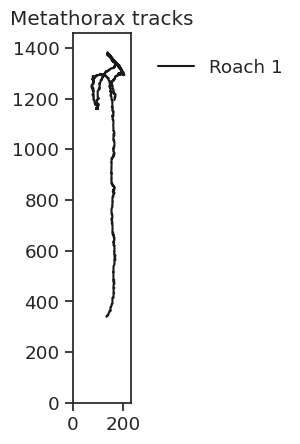

In [ ]:
# Tracks for entire video

sns.set('notebook', 'ticks', font_scale=1.2)

#To track for first x frames, uncomment below two lines below
#for i in range(1): #if multiple mice change 1 to # of mice
#    plt.plot(tracks_matrix[i,0,3,0:1000],tracks_matrix[i,1,3,0:1000]) #Replace 1000 with the number of frames desired

plt.plot(Metathorax_loc[:,0,0],-1* Metathorax_loc[:,1,0] + videoSizeY, 'k',label='Roach 1')
# plt.plot(Metathorax_loc[:,0,1],Metathorax_loc[:,1,1], 'k',label='Roach 2')
#uncomment above to track multiple roaches

plt.legend()
leg = plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=1)

plt.xlim(0,videoSizeX)
#plt.xticks([])

plt.ylim(0,videoSizeY)
#plt.yticks([])
plt.gca().set_aspect('equal', adjustable='box')
plt.title('Metathorax tracks')
plt.gca().set_aspect('equal', adjustable='box')



## Determine time spent in each qudrant and total distance travelled

Total distance traveled (m): 2.1427268574628964
Total time (s): 119.89999999999999

Quartile 1 distance traveled (m): 0.06132059525617767
Time spent in Quartile 1 (s): 2.2666666666666666

Quartile 2 distance traveled (m): 0.17785247397294654
Time spent in Quartile 2 (s): 7.966666666666667

Quartile 3 distance traveled (m): 0.10158179814988628
Time spent in Quartile 3 (s): 16.133333333333333

Quartile 4 distance traveled (m): 1.6767168604656124
Time spent in Quartile 4 (s): 93.53333333333333



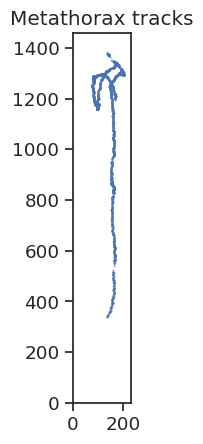

In [ ]:
# Determine time spent and distance traveled in total
xadjust = 0
yadjust = 0
#Create a restricted area of interest by limiting x and y pixels of the video
preBox = pd.DataFrame({'metaX': Metathorax_loc[:, 0,0] + xadjust, 'metaY': (-1*Metathorax_loc[:, 1,0] + yadjust) + videoSizeY }) #convert location tracks to dataframe. Metathorax chosen here.
boxRestrictX=preBox[(preBox['metaX'] >= 0 ) & (preBox['metaX'] <= videoSizeX)] #define location of restricted region of interest along x axis.
boxRestricteXY=preBox[(preBox['metaY'] >= 0) & (preBox['metaY'] <= videoSizeY)] #define location of restricted region of interest along y axis. In this case, it is the whole box

box = boxRestricteXY

#total distance traveled
test=boxRestricteXY.to_numpy() #change back to array for distance calculation
totaldist = 0 #creates dataframe
for i in range(0, len(test)-1):
    totaldist += distance.euclidean(test[i], test[i+1])*(1/ppd)*(1/100) #calculates pixels per distance (in cm) and divides by 100 to obtain distance in meters

######################################################################################
#total time in chamber
totaltime = box.shape[0]*(1/fps) #calculates time based on frames per second
plt.scatter(box['metaX'],box['metaY'], s = 0.1)
plt.xlim(0,videoSizeX)
#plt.xticks([])
plt.ylim(0,videoSizeY)
#plt.yticks([])
plt.gca().set_aspect('equal', adjustable='box')
plt.title('Metathorax tracks')

######################################################################################
# 1st Quartile tracks
ROIX = box[(box['metaX'] >= 0) & (box['metaX'] <= videoSizeX)] # Define region of interest (ROI) along x axis for this quartile
Q1=box[(ROIX['metaY'] >= 0) & (ROIX['metaY'] <= quarterLineBottom)] #Define region of interest along y axis for this quartile

#Quartile 1 distance traveled
Q1values=Q1.to_numpy()
Q1Distance = 0
for i in range(0, len(Q1values)-1):
    Q1Distance += distance.euclidean(Q1values[i], Q1values[i+1])*(1/ppd)*(1/100)

#time in Q1
Q1Time = Q1values.shape[0]*(1/fps)

######################################################################################
# 2nd Quartile tracks
ROIX = box[(box['metaX'] >= 0) & (box['metaX'] <= videoSizeX)] # Define region of interest (ROI) along x axis for this quartile
Q2=box[(ROIX['metaY'] >= quarterLineBottom) & (ROIX['metaY'] <= videoSizeY/2)] #Define region of interest along y axis for this quartile

#Quartile 2 distance traveled
Q2values=Q2.to_numpy()
Q2Distance = 0
for i in range(0, len(Q2values)-1):
    Q2Distance += distance.euclidean(Q2values[i], Q2values[i+1])*(1/ppd)*(1/100)

#time in Q2
Q2Time = Q2values.shape[0]*(1/fps)

######################################################################################
# 3rd Quartile tracks
ROIX = box[(box['metaX'] >= 0) & (box['metaX'] <= videoSizeX)] # Define region of interest (ROI) along x axis for this quartile
Q3=box[(ROIX['metaY'] >= videoSizeY/2) & (ROIX['metaY'] <= quarterLineTop)] #Define region of interest along y axis for this quartile

#Quartile 3 distance traveled
Q3values=Q3.to_numpy()
Q3Distance = 0
for i in range(0, len(Q2values)-1):
    Q3Distance += distance.euclidean(Q3values[i], Q3values[i+1])*(1/ppd)*(1/100)

#time in Q3
Q3Time = Q3values.shape[0]*(1/fps)

######################################################################################
# 4th Quartile tracks
ROIX = box[(box['metaX'] >= 0) & (box['metaX'] <= videoSizeX)] # Define region of interest (ROI) along x axis for this quartile
Q4=box[( ROIX['metaY'] >= quarterLineTop ) & (ROIX['metaY'] <= videoSizeY)] #Define region of interest along y axis for this quartile

#Quartile 4 distance traveled
Q4values=Q4.to_numpy()
Q4Distance = 0
for i in range(0, len(Q4values)-1):
    Q4Distance += distance.euclidean(Q4values[i], Q4values[i+1])*(1/ppd)*(1/100)

#time in Q4
Q4Time = Q4values.shape[0]*(1/fps)


print('Total distance traveled (m):', totaldist)
print('Total time (s):', totaltime)
print('')
print('Quartile 1 distance traveled (m):', Q1Distance)
print('Time spent in Quartile 1 (s):', Q1Time) #seconds in defined component of the box
print('')
print('Quartile 2 distance traveled (m):', Q2Distance)
print('Time spent in Quartile 2 (s):', Q2Time) #seconds in defined component of the box
print('')
print('Quartile 3 distance traveled (m):', Q3Distance)
print('Time spent in Quartile 3 (s):', Q3Time) #seconds in defined component of the box
print('')
print('Quartile 4 distance traveled (m):', Q4Distance)
print('Time spent in Quartile 4 (s):', Q4Time) #seconds in defined component of the box
print('')

## Calculate Boundary Crossings

In [ ]:
def count_boundary_crossings(y_coordinates, boundary_positions):
    crossings = [0] * len(boundary_positions)
    previous_position = y_coordinates[0]

    for position in y_coordinates[1:]:
        for i, boundary_y in enumerate(boundary_positions):
            if (previous_position < boundary_y and position >= boundary_y) or \
               (previous_position > boundary_y and position <= boundary_y):
                crossings[i] += 1
        previous_position = position

    return crossings

# Calculate boundary crossings for multiple boundaries for the 'Head' node
anchor_y_coordinates = -1*anchor[:, 1,0] + videoSizeY
boundary_positions = [quarterLineBottom, halfLine, quarterLineTop]  # Specify the y-positions of the boundaries

crossings = count_boundary_crossings(anchor_y_coordinates, boundary_positions)

print("Number of crossings for each boundary:")
for i, boundary_y in enumerate(boundary_positions):
    print(f"Boundary {i + 1} ({boundary_y}): {crossings[i]} crossings.")

Number of crossings for each boundary:
Boundary 1 (435): 1 crossings.
Boundary 2 (755): 1 crossings.
Boundary 3 (1075): 1 crossings.


##Generate heatmap with scatter

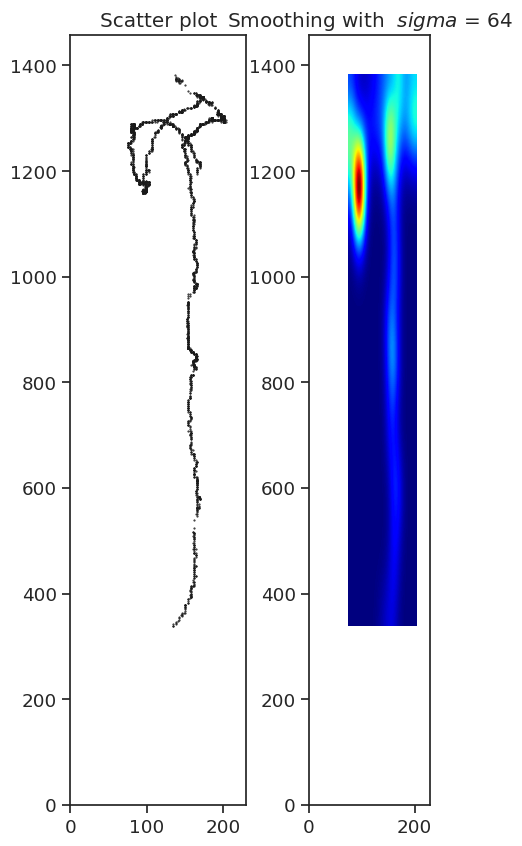

In [ ]:
#make heatmaps
x = box['metaX']
y = box['metaY']

fig, axs = plt.subplots(1, 2,figsize=(5, 10))

def myplot(x, y, s, bins=1000):
    heatmap, xedges, yedges = np.histogram2d(x, y, bins=bins)
    heatmap = gaussian_filter(heatmap, sigma=s)
    extent = [xedges[0], xedges[-1], yedges[0], yedges[-1]]
    return heatmap.T, extent

sigmas = [0, 64]
for ax, s in zip(axs.flatten(), sigmas):
    if s == 0:
        ax.plot(x, y, 'k.', markersize=1)
        ax.set_title("Scatter plot")
        ax.set_xlim(0,videoSizeX+xadjust)
        ax.set_ylim(0,videoSizeY)
    else:
        img, extent = myplot(x, y, s)
        ax.imshow(img, extent=extent, origin='lower', cmap=cm.jet)
        ax.set_xlim(0,videoSizeX)
        ax.set_ylim(0,videoSizeY)
        ax.set_title("Smoothing with  $sigma$ = %d" % s)
        # plt.savefig(file + "centroidscatterandheatmap.jpg")

plt.show()

## Generate line plot in different colors per chamber

<ipython-input-20-7bbcaf6c4bab>:22: MatplotlibDeprecationWarning: The legendHandles attribute was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use legend_handles instead.
  for handle in leg.legendHandles:


(0.0, 1458.0)

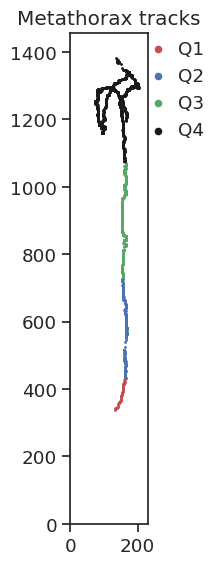

In [ ]:
data = {'Q1': {'color': 'r', 'condition': (box['metaY'] > 0) & (box['metaY'] <= quarterLineBottom)},
        'Q2': {'color': 'b', 'condition': (box['metaY'] > quarterLineBottom) & (box['metaY'] <= videoSizeY/2)},
        'Q3': {'color': 'g', 'condition': (box['metaY'] > videoSizeY/2) & (box['metaY'] <= quarterLineTop)},
        'Q4': {'color': 'k', 'condition': (box['metaY'] > quarterLineTop)}}

s = 1  # Adjust the size as needed

fig, ax = plt.subplots(figsize=(s, s*10))

for label, settings in data.items():
    ax.scatter(box['metaX'][settings['condition']],
               box['metaY'][settings['condition']],
               color=settings['color'], label=label, s=s)

# Set aspect ratio to equal
ax.set_aspect('equal', adjustable='box')

# Set Aesthetics
leg = plt.legend(bbox_to_anchor=(.8, 1), loc='upper left', borderaxespad=0, handletextpad=0.1)

# Set legend marker sizes
for handle in leg.legendHandles:
    handle.set_sizes([s*20])

ax.set_title('Metathorax tracks')
plt.xlim(0, videoSizeX)
plt.ylim(0, videoSizeY)

# Show the plot
# plt.show()

# plt.savefig('fig.svg', format='svg', bbox_inches='tight')
# files.download('fig.svg')

## Visualize tracks over a video frame

shape is (1458, 230, 3)
pixel at (60,21) [214 219 222]
pixel at (120,10) [214 217 220]


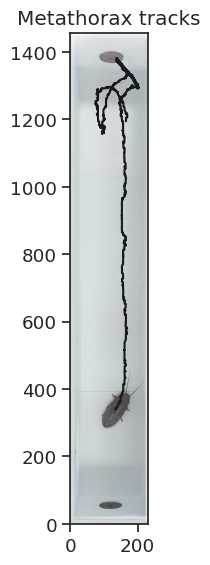

In [ ]:
import pandas as pd
import cv2
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

Video_FILE = r"/content/drive/SLEAP Starter Kit/2_SampleVideo.mp4" # Change pathway to your video

def get_frames(filename):
    video=cv2.VideoCapture(filename)
    while video.isOpened():
        rete,frame=video.read()
        if rete:
            yield frame
        else:
            break
        video.release()
        yield None

def get_frame(filename,index):
    counter=0
    video=cv2.VideoCapture(filename)
    while video.isOpened():
        rete,frame=video.read()
        if rete:
            if counter==index:
                return frame
            counter +=1
        else:
            break
    video.release()
    return None

frame = get_frame(Video_FILE,1)
print('shape is', frame.shape)
print('pixel at (60,21)',frame[60,21,:])
print('pixel at (120,10)',frame[120,10,:])
img = np.flipud(frame)
img = img/255.0

s = 1  # Adjust the size as needed

plt.figure(figsize=(s, s*10))
plt.plot(box['metaX'], box['metaY'], 'k')
# plt.xticks(np.arange(0, len(box['metaX'])+1, 20),fontsize=10, rotation=45)
# plt.yticks(np.arange(0, len(box['metaY'])+1, 20))
plt.xlim(0,videoSizeX)
plt.ylim(0,videoSizeY)
plt.gca().set_aspect('equal', adjustable='box')
plt.title('Metathorax tracks')
plt.imshow(img)

# plt.savefig(file + "movieandtracks.jpg")

## Visualize x-y dynamics and velocity

Text(0.5, 1.0, 'Velocity')

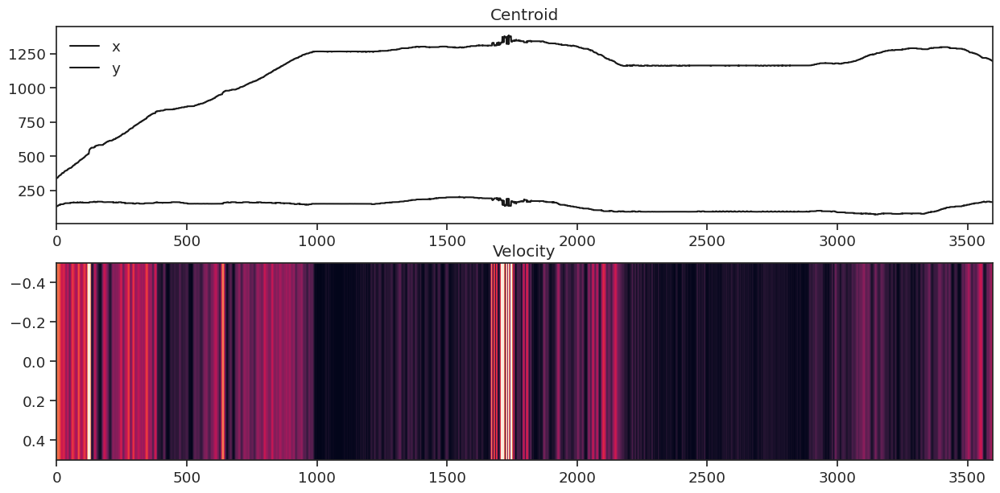

In [ ]:
from scipy.signal import savgol_filter

def smooth_diff(node_loc, win=25, poly=3):
    """
    node_loc is a [frames, 2] array

    win defines the window to smooth over

    poly defines the order of the polynomial
    to fit with

    """
    node_loc_vel = np.zeros_like(node_loc)

    for c in range(node_loc.shape[-1]):
        node_loc_vel[:, c] = savgol_filter(node_loc[:, c], win, poly, deriv=1)

    node_vel = np.linalg.norm(node_loc_vel,axis=1)

    return node_vel

centroid_vel_roach = smooth_diff(Metathorax_loc[:, :, 0])

fig = plt.figure(figsize=(15,7))
ax1 = fig.add_subplot(211)
ax1.plot(Metathorax_loc[:, 0, 0], 'k', label='x')
ax1.plot(-1*Metathorax_loc[:, 1, 0] + videoSizeY, 'k', label='y')
ax1.legend()
ax1.set_title('Centroid')

ax2 = fig.add_subplot(212, sharex=ax1)
ax2.imshow(centroid_vel_roach[:,np.newaxis].T, aspect='auto', vmin=0, vmax=3)
ax2.set_title('Velocity')

## Visualize node colored by magnitude of speed


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

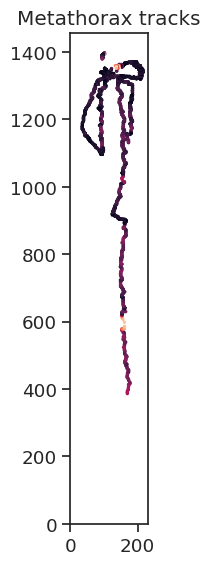

In [ ]:
kp = centroid_vel_roach
vmin = 0
vmax = 5

plt.figure(figsize=(s, s*10))
plt.scatter(anchor[:,0,0], videoSizeY - anchor[:,1,0], c=kp, s=2, vmin=vmin, vmax=vmax)
plt.xlim(0,videoSizeX)
plt.ylim(0,videoSizeY)
# plt.yticks(np.arange(0, len(box['metaY'])+1, 20))
# plt.xticks(np.arange(0, len(box['metaX'])+1, 20),fontsize=10, rotation=45)
plt.gca().set_aspect('equal', adjustable='box')
plt.title('Metathorax tracks')

# plt.savefig('fig.svg', format='svg', bbox_inches='tight')
# files.download('fig.svg')

##Unsupervised clustering of behaviors using kmeans

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Count for 0 18.666666666666668
Count for 1 40.86666666666667
Count for 2 2.7666666666666666
Count for 3 36.4
Count for 4 21.2


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

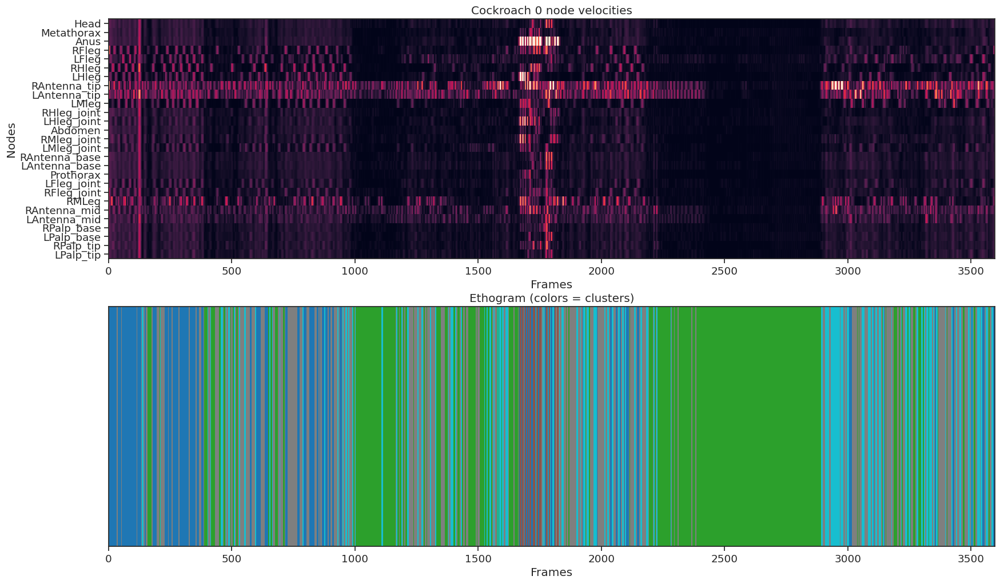

In [ ]:
from sklearn.cluster import KMeans

def instance_node_velocities(instance_idx):
    node_locations = locations[:, :, :, instance_idx]
    node_velocities = np.zeros((frame_count, node_count))

    for n in range(0, node_count):
        node_velocities[:, n] = smooth_diff(node_locations[:, n, :])

    return node_velocities


roach_ID = 0
node_velocities = instance_node_velocities(roach_ID)

fig = plt.figure(figsize=(20, 12))

ax1 = fig.add_subplot(211)
ax1.imshow(node_velocities.T, aspect="auto", vmin=0, vmax=10, interpolation="nearest")
ax1.set_xlabel("Frames")
ax1.set_ylabel("Nodes")
ax1.set_yticks(np.arange(node_count))
ax1.set_yticklabels(node_names);
ax1.set_title(f"Cockroach {roach_ID} node velocities")
ax1.set_xlim(0,frame_count)

# ————————————————————— Plot K-Means Clustering ————————————————————————
nstates = 5
km = KMeans(n_clusters=nstates)
labels = km.fit_predict(node_velocities)

# Calculate total number of seconds per cluster
unique, counts = np.unique(labels, return_counts=True)
counts_sorted = np.sort(counts)
behaviors = labels.tolist() #time in a behavior in seconds
print ("Count for 0", behaviors.count(0)/fps)
print ("Count for 1", behaviors.count(1)/fps)
print ("Count for 2", behaviors.count(2)/fps)
print ("Count for 3", behaviors.count(3)/fps)
print ("Count for 4", behaviors.count(4)/fps)
#print ("Count for 5", behaviors.count(5)/fps)
#print ("Count for 6", behaviors.count(6)/fps)
#print ("Count for 7", behaviors.count(7)/fps)
#print ("Count for 8", behaviors.count(8)/fps)
#print ("Count for 9", behaviors.count(9)/fps)
#print ("Count for 10", behaviors.count(10)/fps)

ax2 = fig.add_subplot(212,sharex=ax1)
ax2.imshow(labels[None, :], aspect="auto", cmap="tab10", interpolation="nearest")
ax2.set_xlabel("Frames")
ax2.set_yticks([])
ax2.set_title("Ethogram (colors = clusters)");

# plt.savefig('fig.svg', format='svg', bbox_inches='tight')
# files.download('fig.svg')

## Overlay tracks on video

shape is (1458, 230, 3)
pixel at (60,21) [213 219 222]
pixel at (120,10) [217 219 223]


<ipython-input-26-c7b669b75471>:71: MatplotlibDeprecationWarning: The legendHandles attribute was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use legend_handles instead.
  for handle in leg.legendHandles:


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

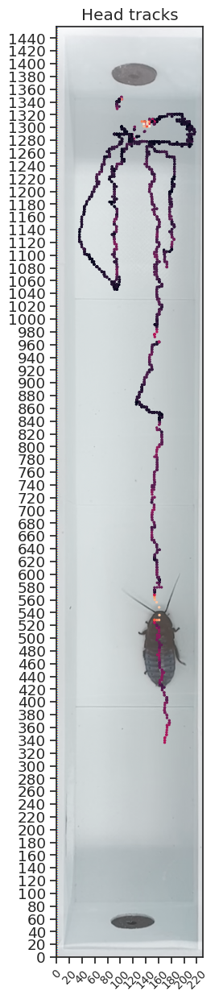

In [ ]:
import pandas as pd
import cv2
import matplotlib.pyplot as plt

Video_FILE = r"/content/drive/SLEAP Starter Kit/2_SampleVideo.mp4" # Change pathway to your video


def get_frames(filename):
    video=cv2.VideoCapture(filename)
    while video.isOpened():
        rete,frame=video.read()
        if rete:
            yield frame
        else:
            break
        video.release()
        yield None

def get_frame(filename,index):
    counter=0
    video=cv2.VideoCapture(filename)
    while video.isOpened():
        rete,frame=video.read()
        if rete:
            if counter==index:
                return frame
            counter +=1
        else:
            break
    video.release()
    return None

frame = get_frame(Video_FILE,100)
print('shape is', frame.shape)
print('pixel at (60,21)',frame[60,21,:])
print('pixel at (120,10)',frame[120,10,:])


img = np.flipud(frame)
img = img/255.0
positionAdjust = -50
plt.figure(figsize=(15,15))

# ————— Uncomment below to show tracks (you can add to the y axix to account for video positioning) —————
# plt.plot(box['metaX'],box['metaY'], 'k')

# ————— Uncomment below to show tracks color-coded for each quadrant (you can add to the y axid to account for video positioning) —————
# data = {'Q1': {'color': 'r', 'condition': (box['metaY'] > 0) & (box['metaY'] <= quarterLineBottom)},
#         'Q2': {'color': 'b', 'condition': (box['metaY'] > quarterLineBottom) & (box['metaY'] <= videoSizeY/2)},
#         'Q3': {'color': 'g', 'condition': (box['metaY'] > videoSizeY/2) & (box['metaY'] <= quarterLineTop)},
#         'Q4': {'color': 'k', 'condition': (box['metaY'] > quarterLineTop)}}

# s = 1  # Adjust the size as needed
# fig, ax = plt.subplots(figsize=(s*15, s*15))
# for label, settings in data.items():
#     ax.scatter(box['metaX'][settings['condition']],
#                box['metaY'][settings['condition']],
#                color=settings['color'], label=label, s=s)


# ————— Uncomment below to show tracks as velocity heat map (you can add to the y axid to account for video positioning) —————
plt.scatter(anchor[:,0,0], videoSizeY - anchor[:,1,0] + positionAdjust, c=kp, s=2, vmin=vmin, vmax=vmax)

# ————— Do not uncomment below; this controld figure aesthetics —————
# Set aspect ratio to equal
ax.set_aspect('equal', adjustable='box')

# Set Aesthetics
leg = plt.legend(bbox_to_anchor=(1, 1), loc='upper left', borderaxespad=0, handletextpad=0.1)

# Set legend marker sizes
for handle in leg.legendHandles:
    handle.set_sizes([s*10])

ax.set_title('Metathorax tracks')
plt.xlim(0, videoSizeX)
plt.ylim(0, videoSizeY)

plt.xticks(np.arange(0, len(anchor[:,0,0])+1, 20),fontsize=10, rotation=45)
plt.yticks(np.arange(0, len(anchor[:,0,0])+1, 20))
plt.xlim(0,videoSizeX)

plt.ylim(0,videoSizeY)
plt.gca().set_aspect('equal', adjustable='box')
plt.title(anchorName + ' tracks')
plt.imshow(img)

# plt.savefig('fig.svg', format='svg', bbox_inches='tight')
# files.download('fig.svg')

## Create GIF of Instances

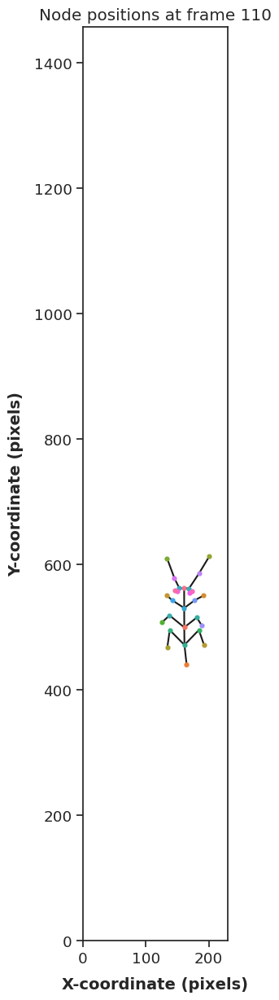

In [ ]:
# Define the frame number you want to plot (change this to your desired frame)
frame_number = 110

# Create a color map for differentiating between multiple animals
colors = ['b', 'g', 'r']

seaborn_palette = sns.color_palette("husl", n_colors=len(node_names))
node_colors = dict(zip(node_names, seaborn_palette))

edges = [
        ['Metathorax', 'Abdomen'],
        ['Abdomen' , 'Anus'],
        ['Metathorax' , 'RMleg_joint'],
        ['Metathorax' , 'LMleg_joint'],
        ['LMleg_joint' , 'LMleg'],
        ['Abdomen' , 'RHleg_joint'],
        ['Abdomen' , 'LHleg_joint'],
        ['RHleg_joint' , 'RHleg'],
        ['LHleg_joint' , 'LHleg'],
        ['Head' , 'RAntenna_base'],
        ['Head' , 'LAntenna_base'],
        ['Head' , 'Prothorax'],
        ['Prothorax' , 'Metathorax'],
        ['Prothorax' , 'LFleg_joint'],
        ['Prothorax' , 'RFleg_joint'],
        ['LFleg_joint' , 'LFleg'],
        ['RFleg_joint' , 'RFleg'],
        ['RMLeg' , 'RMleg_joint'],
        ['RAntenna_base' , 'RAntenna_mid'],
        ['LAntenna_base' , 'LAntenna_mid'],
        ['RAntenna_mid' , 'RAntenna_tip'],
        ['LAntenna_mid' , 'LAntenna_tip'],
        ['RPalp_base' , 'RPalp_tip'],
        ['LPalp_tip' , 'LPalp_base'],
        ['RPalp_base' , 'RAntenna_base'],
        ['LPalp_base' , 'LAntenna_base']
]

# Plot all nodes for all animals on a single plot
plt.figure(figsize=(videoSizeX/100, videoSizeY/100))

for node_index, node_name in enumerate(node_names):
    plt.title(f'Node positions at frame {frame_number}')
    plt.xlabel('X-coordinate (pixels)',fontsize=14,  labelpad = 9, fontweight='bold')
    plt.ylabel('Y-coordinate (pixels)',fontsize=14,  labelpad = 9, fontweight='bold')

    for i in range(1):  # Loop through each animal
        x = locations[frame_number, node_index, 0, i]
        y = locations[frame_number, node_index, 1, i]
        # Get the color from the dictionary based on the node name
        node_color = node_colors.get(node_name, 'black')  # Default to black if not found
        plt.scatter(x, videoSizeY- y, label=f'{node_name} - Mouse {i + 1}', color=node_color, zorder=2, s=12)

# Connect points using edge names
for edge in edges:
    node1_index = node_names.index(edge[0])
    node2_index = node_names.index(edge[1])

    for i in range(1):  # Loop through each animal
        x1 = locations[frame_number, node1_index, 0, i]
        y1 = locations[frame_number, node1_index, 1, i]
        x2 = locations[frame_number, node2_index, 0, i]
        y2 = locations[frame_number, node2_index, 1, i]

        plt.plot([x1, x2], [ videoSizeY- y1,  videoSizeY- y2], color='k', zorder=1)

# Add legend
plt.legend('')
plt.xlim(0, videoSizeX)
plt.ylim(0, videoSizeY)
plt.grid(False)

# Show the plot

plt.show()

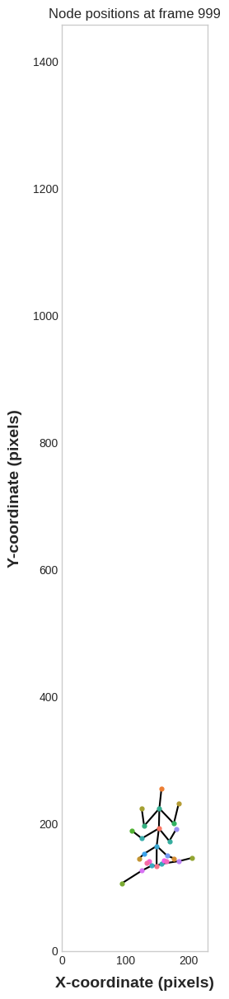

In [ ]:
#CREATE MOVIE!

import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

# Define the frame numbers you want to plot (change this to your desired frames)
frame_numbers = range(100, 1000)  # for example, frames 100 to 150

# Create a function to update the plot for each frame
def update(frame_number):
    plt.clf()  # clear the current plot

    # Plot all nodes for all three animals on a single plot
    for node_index, node_name in enumerate(node_names):
        plt.title(f'Node positions at frame {frame_number}')
        plt.xlabel('X-coordinate (pixels)',fontsize=14,  labelpad = 9, fontweight='bold')
        plt.ylabel('Y-coordinate (pixels)',fontsize=14,  labelpad = 9, fontweight='bold')

        for i in range(1):  # Loop through each animal
            x = locations[frame_number, node_index, 0, i]
            y = locations[frame_number, node_index, 1, i]
            # Get the color from the dictionary based on the node name
            node_color = node_colors.get(node_name, 'black')  # Default to black if not found
            plt.scatter(x,  videoSizeY-y, label=f'{node_name} - Mouse {i + 1}', color=node_color, zorder=2, s=12)


    # Connect points using edge names
    for edge in edges:
        node1_index = node_names.index(edge[0])
        node2_index = node_names.index(edge[1])

        for i in range(1):  # Loop through each animal
            x1 = locations[frame_number, node1_index, 0, i]
            y1 = locations[frame_number, node1_index, 1, i]
            x2 = locations[frame_number, node2_index, 0, i]
            y2 = locations[frame_number, node2_index, 1, i]

            plt.plot([x1, x2], [ videoSizeY-y1,  videoSizeY-y2], color='k', zorder=1)

        plt.xlim(0, videoSizeX)
        plt.ylim(0, videoSizeY)

    plt.grid(False)

# Create the animation
ani = FuncAnimation(plt.figure(figsize=(videoSizeX/100, videoSizeY/100)), update, frames=frame_numbers, interval=100)

file = '/content/drive/SLEAP Starter Kit/'
ani.save(file + 'animation.mp4', writer='ffmpeg')

# Display the animation
from IPython.display import HTML
HTML(ani.to_jshtml())


# **4.** Plot Figures
We plot figures based on data obtained from a google sheet file

In [ ]:
from google.colab import auth
auth.authenticate_user()

import gspread
import matplotlib.ticker as plticker
from google.auth import default
creds, _ = default()

gc = gspread.authorize(creds)

##🟣 Plot avg time spent in certain quadrant across days

<ipython-input-20-5c2e78b4ffb2>:2: FutureWarning: In a future version of pandas all arguments of DataFrame.dropna will be keyword-only.
  df = get_as_dataframe(sheet).dropna(0, 'all').dropna(1, 'all')
<ipython-input-20-5c2e78b4ffb2>:29: FutureWarning: 

The `errcolor` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'color': 'black'}` instead.

  ax = sns.barplot(x=df1.Day, y= df1.Time, data=df1, hue=df1.Group, dodge=True, palette=palette, errwidth = s,
<ipython-input-20-5c2e78b4ffb2>:29: FutureWarning: 

The `errwidth` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'linewidth': 10}` instead.

  ax = sns.barplot(x=df1.Day, y= df1.Time, data=df1, hue=df1.Group, dodge=True, palette=palette, errwidth = s,
<ipython-input-20-5c2e78b4ffb2>:31: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['','Day 1','Day 7','Day 14'],fontsize=12, fontweight='bold')
<ipython-input-20-5c2e78b4ffb2>:32: FutureWarn

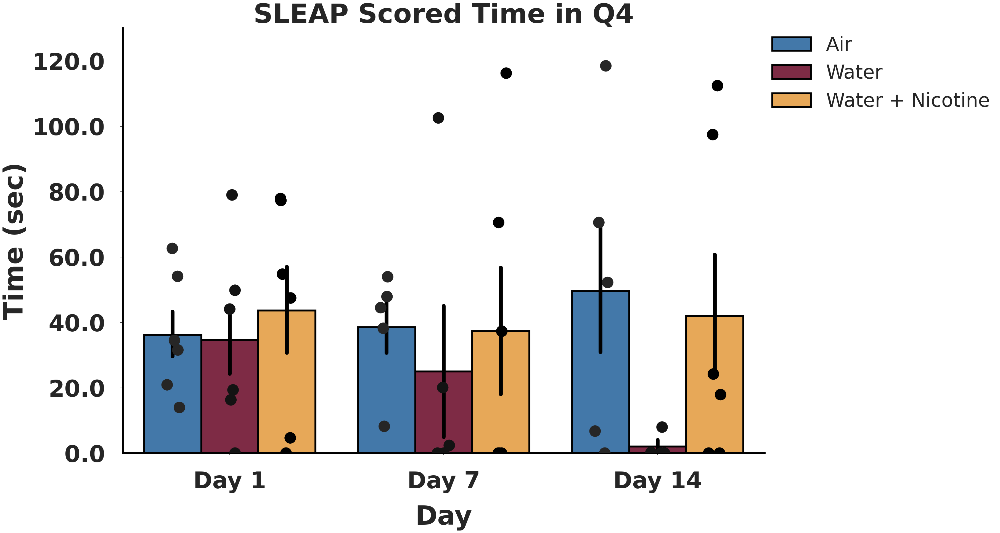

In [ ]:
sheet = gc.open('8_Example_Datasheet').worksheet("Comparisons Formatted")
df = get_as_dataframe(sheet).dropna(0, 'all').dropna(1, 'all')
df1 = df[df.Group.notna()]
df1 = df1[df1.Day != 2]
df1 = df1[df1.Day != 3]
df1 = df1[df1.Day != 4]
df1 = df1[df1.Day != 5]
df1 = df1[df1.Day != 6]
df1 = df1[df1.Day != 8]
df1 = df1[df1.Day != 9]
df1 = df1[df1.Day != 10]
df1 = df1[df1.Day != 11]
df1 = df1[df1.Day != 12]
df1 = df1[df1.Day != 13]
df1 = df1[df1.Quadrant == 'Q4']
# df1 = df1[df1.ScoreType == 'Hand Scored']
df1 = df1[df1.ScoreType == 'SLEAP']
df1['Time'] = pd.to_numeric(df1['Time'], errors='coerce')
df1.reset_index(drop=True, inplace=True)
# pd.DataFrame.from_records(df1)

s = 10 #The size of the figure
plt.figure(figsize = (3*s,2*s))
plt.ylim(0,130)
palette={'Air':'#3279ba','Water':'#8C1D40','Water + Nicotine':'#ffab40'}
hue_order = ['Air', 'Water', 'Water + Nicotine']

# Create the bar plot
ax = sns.barplot(x=df1.Day, y= df1.Time, data=df1, hue=df1.Group, dodge=True, palette=palette, errwidth = s,
                 linewidth=s/2, edgecolor='black', hue_order = hue_order, errorbar=('ci', 69), errcolor = 'black')
ax.set_xticklabels(['','Day 1','Day 7','Day 14'],fontsize=12, fontweight='bold')
sns.stripplot(x=df1.Day, y= df1.Time, data=df1, hue=df1.Group, dodge=True, color = '#000000',
                 hue_order = hue_order, jitter=True, size=s*3, legend = False)

# Adjust Legend
if(ax.get_legend() != None):
  legend_labels = ['Air', 'Water', 'Water + Nicotine']
  leg = plt.legend(bbox_to_anchor=(1, 1),loc='upper left', borderaxespad=0, markerscale = 10*s, prop={'size':5*s})
  for t, l in zip(leg.texts, legend_labels):
      t.set_text(l)

# #Adjust Gridlines
sns.despine(right=True)
ax.spines['left'].set_linewidth(s/2)
ax.spines['bottom'].set_linewidth(s/2)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.grid(False)
ax.set_yticklabels(ax.get_yticks(),fontsize=12, fontweight='bold')
ax.tick_params(pad = 4*s, labelsize = 6*s)
loc = plticker.MultipleLocator(base=1.0) # this locator puts ticks at regular intervals
ax.xaxis.set_major_locator(loc)

#Adjust Labels/Titles
plt.ylabel('Time (sec)',fontsize=7*s,  labelpad = 1*s, fontweight = 'bold' )
plt.xlabel('Day', fontsize=7*s, labelpad = 3*s, fontweight = 'bold' )

if df1.ScoreType[0] == 'Hand Scored':
  plt.title(f'Hand Scored Time in {df1.Quadrant[0]}', fontsize=7*s, fontweight = 'bold' )
else:
  plt.title(f'SLEAP Scored Time in {df1.Quadrant[0]}', fontsize=7*s, fontweight = 'bold' )

# plt.savefig(f'{df1.ScoreType[0]}_{df1.Quadrant[0]}.svg', format='svg', bbox_inches='tight')
# files.download(f'{df1.ScoreType[0]}_{df1.Quadrant[0]}.svg')

##🟣 Statistical Tests

### Set up datasheet

In [ ]:
#—————————————————————————————— Set up your data ——————————————————————————————
sheet = gc.open('8_Example_Datasheet').worksheet("Comparisons Formatted")
df = get_as_dataframe(sheet).dropna(axis=0, how='all').dropna(axis=1, how='all')
df1 = df[df.Group.notna()]
# df1 = df1[df1.Day != 1]
# df1 = df1[df1.Day != 2]
# df1 = df1[df1.Day != 3]
# df1 = df1[df1.Day != 4]
# df1 = df1[df1.Day != 5]
# df1 = df1[df1.Day != 6]
# df1 = df1[df1.Day != 7]
# df1 = df1[df1.Day != 8]
# df1 = df1[df1.Day != 9]
# df1 = df1[df1.Day != 10]
# df1 = df1[df1.Day != 11]
# df1 = df1[df1.Day != 12]
# df1 = df1[df1.Day != 13]
# df1 = df1[df1.Day != 14]
df1 = df1[df1.Quadrant == 'Q3']
df1 = df1[df1.Day ==7]
# df1 = df1[df1.Group == 'Air']  # Air  Water  Water + Nicotine
df1 = df1[df1.ScoreType == 'Hand Scored']
# df1 = df1[df1.ScoreType == 'SLEAP']
df1 = df1[df1.Time.notna()]

df1['Time'] = pd.to_numeric(df1['Time'], errors='coerce')
df1['Distance'] = pd.to_numeric(df1['Distance'], errors='coerce')
df1['Group'] = df1['Group'].astype(str)
df1['Subject'] = df1['Subject'].astype(str)
pd.DataFrame.from_records(df1)


,Day,Group,ScoreType,Grouping,Quadrant,Time,Distance,Subject,Unnamed: 8,Unnamed: 9
0,7.0,Water,Hand Scored,Hand Scored - Water,Q3,0.0,NaN,Water_2,NaN,NaN
1,7.0,Water,Hand Scored,Hand Scored - Water,Q3,9.0,NaN,Water_3,NaN,NaN
2,7.0,Water,Hand Scored,Hand Scored - Water,Q3,0.0,NaN,Water_4,NaN,NaN
3,7.0,Water,Hand Scored,Hand Scored - Water,Q3,0.0,NaN,Water_5,NaN,NaN
4,7.0,Water,Hand Scored,Hand Scored - Water,Q3,16.0,NaN,Water_6,NaN,NaN
5,7.0,Water + Nicotine,Hand Scored,Hand Scored - Water + Nicotine,Q3,0.0,NaN,Water + Nicotine_1,NaN,NaN
6,7.0,Water + Nicotine,Hand Scored,Hand Scored - Water + Nicotine,Q3,0.0,NaN,Water + Nicotine_2,NaN,NaN
7,7.0,Water + Nicotine,Hand Scored,Hand Scored - Water + Nicotine,Q3,14.0,NaN,Water + Nicotine_3,NaN,NaN
8,7.0,Water + Nicotine,Hand Scored,Hand Scored - Water + Nicotine,Q3,25.0,NaN,Water + Nicotine_4,NaN,NaN
9,7.0,Water + Nicotine,Hand Scored,Hand Scored - Water + Nicotine,Q3,2.0,NaN,Water + Nicotine_5,NaN,NaN


### Test Normality of data and Equal Variance between groups

In [ ]:
alpha = 0.05  # Set your significance level
parameterCriteria = 0
metric = 'Time'
# metric = 'Distance'

# Perform Shapiro-Wilk test
statistic, p_value = stats.shapiro(df1[metric].dropna().reset_index(drop=True))
print(f"Shapiro-Wilk test statistic: {statistic}, p-value: {p_value}")
if p_value > alpha:
    print("Sample looks normally distributed")
    parameterCriteria = parameterCriteria + 1
else:
    print("Sample does not look normally distributed")

# Perform Levene's test
air = df1[df1.Group == 'Air'][metric].dropna().reset_index(drop=True)
vape = df1[df1.Group == 'Water'][metric].dropna().reset_index(drop=True)
nicotine = df1[df1.Group == 'Water + Nicotine'][metric].dropna().reset_index(drop=True)
statistic, p_value = levene(air, vape, nicotine)
print(f"\nLevene's test statistic: {statistic}, p-value: {p_value}")

# first = df1[df1.Quadrant == 'Q1'][metric].dropna().reset_index(drop=True)
# second = df1[df1.Quadrant == 'Q2'][metric].dropna().reset_index(drop=True)
# third = df1[df1.Quadrant == 'Q3'][metric].dropna().reset_index(drop=True)
# fourth = df1[df1.Quadrant == 'Q4'][metric].dropna().reset_index(drop=True)
# statistic, p_value = levene(first, second, third, fourth)
# print(f"\nLevene's test statistic: {statistic}, p-value: {p_value}")

# Interpret the results
if p_value > alpha:
    print("Variances are approximately equal\n")
    parameterCriteria = parameterCriteria + 1
else:
    print("Variances are significantly different\n")

if parameterCriteria == 2: #If data is both normal and there is equal variance between groups
    print("It is ok to proceed with parametric tests (i.e. ANOVA or T-Tests)\n")
else:
    print("It is not ok to proceed with parametric tests, try a non-parametric test (i.e. Kruskal Wallis and Mann-Whitney)")



Shapiro-Wilk test statistic: 0.8217517137527466, p-value: 0.005376191344112158
Sample does not look normally distributed

Levene's test statistic: 0.6485212492257848, p-value: 0.5389288552214376
Variances are approximately equal

It is not ok to proceed with parametric tests, try a non-parametric test (i.e. Kruskal Wallis and Mann-Whitney)


### Caclulate Effect Size

In [ ]:
# Assuming 'group1' and 'group2' are arrays representing the two groups
# group1 = df1[df1.Quadrant == 'Q1']['Time'].dropna().reset_index(drop=True)
# group2 = df1[df1.Quadrant == 'Q4']['Time'].dropna().reset_index(drop=True)

# Calculate Cohen's d
cohen_d = pg.compute_effsize(group1, group2)
print(f"Cohen's d: {cohen_d}")

Cohen's d: 0.3130783625577355


### Parametric Tests

In [ ]:
#—————————— Mixed ANOVA:  Measures effect of both treatment group and Day on roach's time OR distance travelled ——————————
# Fit the mixed ANOVA model
# model = mixedlm("Time ~ ScoreType", data=df1, groups='Subject').fit()
model = mixedlm("Time ~ Group", data=df1, groups='Subject').fit()
print(model.summary())

#—————————— Tukey post-hoc test ——————————
tukey = pg.pairwise_tukey(data=df1, dv='Time', between='Group')
# tukey = pg.pairwise_tukey(data=df1, dv='Time', between='Group')
print(tukey)

               Mixed Linear Model Regression Results
Model:                  MixedLM     Dependent Variable:     Time    
No. Observations:       18          Method:                 REML    
No. Groups:             18          Scale:                  18.8333 
Min. group size:        1           Log-Likelihood:         -51.1875
Max. group size:        1           Converged:              Yes     
Mean group size:        1.0                                         
--------------------------------------------------------------------
                          Coef.  Std.Err.   z    P>|z| [0.025 0.975]
--------------------------------------------------------------------
Intercept                 14.833    2.481  5.979 0.000  9.971 19.696
Group[T.Water]            -3.167    3.254 -0.973 0.330 -9.544  3.210
Group[T.Water + Nicotine] -0.667    3.254 -0.205 0.838 -7.044  5.710
Subject Var               18.833                                    

       A                 B    mean(A)    mean(B) 

/usr/local/lib/python3.10/dist-packages/statsmodels/regression/mixed_linear_model.py:2262: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


### Non-Parametric Tests

In [ ]:
# —————————— Kruskal-Wallis Test ——————————
metric = 'Time'
# metric = 'Distance'

# Compare between quadrants
# a = df1[df1.Quadrant == 'Q1'][metric].dropna().reset_index(drop=True)
# b = df1[df1.Quadrant == 'Q2'][metric].dropna().reset_index(drop=True)
# c = df1[df1.Quadrant == 'Q3'][metric].dropna().reset_index(drop=True)
# d = df1[df1.Quadrant == 'Q4'][metric].dropna().reset_index(drop=True)
# groups = [a, b, c, d]

# Compare between groups
a = df1[df1.Group == 'Air'][metric].dropna().reset_index(drop=True)
b = df1[df1.Group == 'Water'][metric].dropna().reset_index(drop=True)
c = df1[df1.Group == 'Water + Nicotine'][metric].dropna().reset_index(drop=True)
groups = [a, b, c]

# Calculate p-value
h_statistic, p_value = kruskal(*groups)

print(f"Kruskal-Wallis Test:")
print(f"H statistic: {h_statistic}")
print(f"P-value: {p_value} \n")

# —————————— Post hoc Mann-Whitney U Test ——————————
for i in range(len(groups)):
    for j in range(i + 1, len(groups)):
        u_statistic, p_value = mannwhitneyu(groups[i], groups[j], alternative='two-sided', method='asymptotic', use_continuity=False)
        if i == 0:
          first = 'Air'
        elif i == 1:
          first = 'Water'
        else:
          first = 'Water + Nicotine'
        if j == 1:
          second = 'Water'
        else:
          second = 'Water + Nicotine'
        print(f"Mann-Whitney U Test: between {first} and {second}")
        print(f"U statistic: {u_statistic}")
        print(f"P-value: {p_value}")
        cohen_d = pg.compute_effsize(groups[i], groups[j])
        print(f"Cohen's d: {cohen_d}\n")


Kruskal-Wallis Test:
H statistic: 6.778771384136863
P-value: 0.03372939076885018 

Mann-Whitney U Test: between Air and Water
U statistic: 24.5
P-value: 0.010662274714514686
Cohen's d: 2.8446543457579425

Mann-Whitney U Test: between Air and Water + Nicotine
U statistic: 25.0
P-value: 0.06476896969888761
Cohen's d: 1.7403530014871977

Mann-Whitney U Test: between Water and Water + Nicotine
U statistic: 13.5
P-value: 0.7652104751907526
Cohen's d: -0.19992290960865552



##🟣 Plot avg distance travelled in each quadrant per group

<ipython-input-22-6429338dde18>:2: FutureWarning: In a future version of pandas all arguments of DataFrame.dropna will be keyword-only.
  df = get_as_dataframe(sheet).dropna(0, 'all').dropna(1, 'all')


Confidence intervals for Water and Water + Nicotine do not overlap. Significant difference detected.
Confidence intervals for Water and Air do not overlap. Significant difference detected.
Confidence intervals for Water + Nicotine and Air do not overlap. Significant difference detected.


<ipython-input-22-6429338dde18>:44: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticks(),fontsize=12, fontweight='bold')
<ipython-input-22-6429338dde18>:62: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  coefficients = coefficients.append({'Group': group, 'Coefficient': coeff, 'Std_Error': std_err}, ignore_index=True)
<ipython-input-22-6429338dde18>:62: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  coefficients = coefficients.append({'Group': group, 'Coefficient': coeff, 'Std_Error': std_err}, ignore_index=True)
<ipython-input-22-6429338dde18>:62: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  coefficients = coefficients.append({'Group': group, 'Coefficient': coeff, '

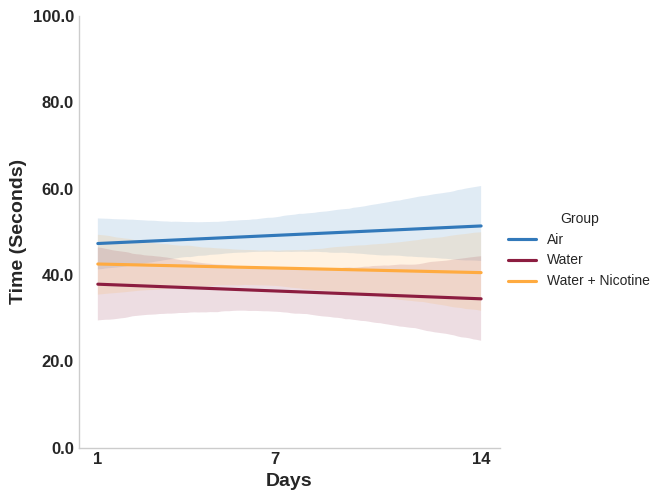

In [ ]:
sheet = gc.open('8_Example_Datasheet').worksheet("Comparisons Formatted")
df = get_as_dataframe(sheet).dropna(0, 'all').dropna(1, 'all')
df1 = df[df.Group.notna()]
# df1 = df1[df1.Day != 2]
# df1 = df1[df1.Day != 3]
# df1 = df1[df1.Day != 4]
# df1 = df1[df1.Day != 5]
# df1 = df1[df1.Day != 6]
# df1 = df1[df1.Day != 8]
# df1 = df1[df1.Day != 9]
# df1 = df1[df1.Day != 10]
# df1 = df1[df1.Day != 11]
# df1 = df1[df1.Day != 12]
# df1 = df1[df1.Day != 13]
df1 = df1[df1.Quadrant == 'Q4']
df1 = df1[df1.ScoreType == 'Hand Scored']
# df1 = df1[df1.ScoreType == 'SLEAP']

df1['Time'] = pd.to_numeric(df1['Time'], errors='coerce')
pd.DataFrame.from_records(df1)

s = 10 #The size of the figure
palette={'Air':'#3279ba','Water':'#8C1D40','Water + Nicotine':'#ffab40'}
hue_order = ['Air', 'Water', 'Water + Nicotine']

#Create Regression Plot
g = sns.lmplot(
    x="Day",  # X-axis data
    y="Time",  # Y-axis data
    hue="Group",  # Color by 'Group'
    data=df1,  # Filtered data for Q4 only
    ci=68,  # Suppress confidence intervals for regression lines
    palette = palette,
    scatter = False,
    hue_order=hue_order
)

# #Adjust Gridlines
for ax in g.axes.flatten():
    ax.grid(False)
    ax.set_xticks([1, 7, 14])  # Set custom x-axis ticks
    ax.set_xticklabels(['1', '7', '14'], fontsize=12, fontweight='bold')  # Set custom x-axis tick labels
    ax.set_ylim(0, 100)
ax.set_yticklabels(ax.get_yticks(),fontsize=12, fontweight='bold')
g.set_axis_labels("Days", "Time (Seconds)", fontsize=14, fontweight='bold')

# Fit separate linear regression models for each group
groups = df1['Group'].unique()
models = {}

for group in groups:
    group_data = df1[df1['Group'] == group]
    model = sm.OLS(group_data['Time'], sm.add_constant(group_data['Day'])).fit()
    models[group] = model

# Extract coefficients and standard errors for each group
coefficients = pd.DataFrame(columns=['Group', 'Coefficient', 'Std_Error'])

for group, model in models.items():
    coeff = model.params['Day']
    std_err = model.bse['Day']
    coefficients = coefficients.append({'Group': group, 'Coefficient': coeff, 'Std_Error': std_err}, ignore_index=True)

# Compare coefficients (slopes) among groups
# For example, here we check for significant differences using confidence intervals
for i in range(len(coefficients)):
    for j in range(i + 1, len(coefficients)):
        group1 = coefficients.iloc[i]
        group2 = coefficients.iloc[j]
        ci1 = (group1['Coefficient'] - 1.96 * group1['Std_Error'], group1['Coefficient'] + 1.96 * group1['Std_Error'])
        ci2 = (group2['Coefficient'] - 1.96 * group2['Std_Error'], group2['Coefficient'] + 1.96 * group2['Std_Error'])

        # Check if confidence intervals overlap
        if ci1[0] <= ci2[1] and ci2[0] <= ci1[1]:
            print(f"Confidence intervals for {group1['Group']} and {group2['Group']} overlap. No significant difference.")
        else:
            print(f"Confidence intervals for {group1['Group']} and {group2['Group']} do not overlap. Significant difference detected.")

# from scipy.stats import ttest_ind
# # Example: Comparing slopes between two groups (assuming coefficients1 and coefficients2 are obtained)
# result = ttest_ind(
#     coefficients[coefficients.Group == 'Air'],
#     coefficients[coefficients.Group == 'Water'],
#     equal_var=False  # Set to False if variances are assumed unequal
# )

# print("T-test statistic:", result.statistic)
# print("P-value:", result.pvalue)

##🟣 Plot avg time or distance travelled in each quadrant per group

<ipython-input-30-a4975bdc89ab>:2: FutureWarning: In a future version of pandas all arguments of DataFrame.dropna will be keyword-only.
  df = get_as_dataframe(sheet).dropna(0, 'all').dropna(1, 'all')
<ipython-input-30-a4975bdc89ab>:20: FutureWarning: 

The `errcolor` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'color': 'black'}` instead.

  ax = sns.barplot(x=df1.Quadrant, y= df1.Distance*100, data=df1, hue=df1.Group, dodge=True, palette=palette, errwidth = s,
<ipython-input-30-a4975bdc89ab>:20: FutureWarning: 

The `errwidth` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'linewidth': 10}` instead.

  ax = sns.barplot(x=df1.Quadrant, y= df1.Distance*100, data=df1, hue=df1.Group, dodge=True, palette=palette, errwidth = s,
<ipython-input-30-a4975bdc89ab>:22: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['Quartile 1','Quartile 2','Quartile 3', 'Quartile 4'],fontsize=12, fontweight='bo

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

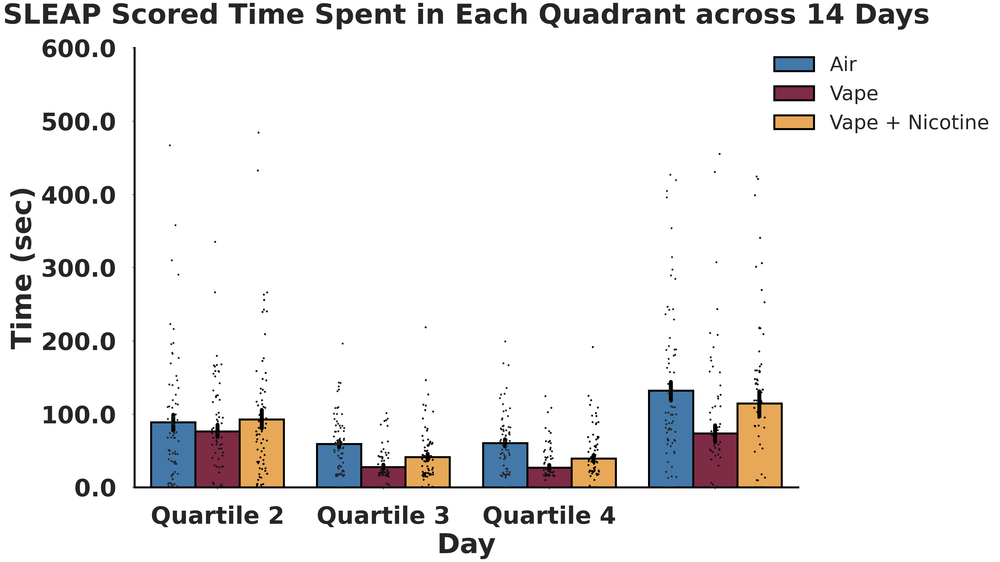

In [ ]:
sheet = gc.open('8_Example_Datasheet').worksheet("Comparisons Formatted")
df = get_as_dataframe(sheet).dropna(0, 'all').dropna(1, 'all')
df1 = df[df.Group.notna()]
df1 = df1[df1.Day.notna()]
df1 = df1[df1.Distance.notna()]
df1 = df1[df1.ScoreType == 'SLEAP']
df1['Distance'] = pd.to_numeric(df1['Distance'], errors='coerce')
# df1 = df1[df1.ScoreType == 'Hand Scored']
df1.reset_index(drop=True, inplace=True)
# pd.DataFrame.from_records(df1)

s = 10 #The size of the figure
plt.figure(figsize = (3*s,2*s))
# plt.ylim(0,130)
plt.ylim(0,600)
palette={'Air':'#3279ba','Water':'#8C1D40','Water + Nicotine':'#ffab40'}
hue_order = ['Air', 'Water', 'Water + Nicotine']

# Create the bar plot
ax = sns.barplot(x=df1.Quadrant, y= df1.Distance*100, data=df1, hue=df1.Group, dodge=True, palette=palette, errwidth = s,
                 linewidth=s/2, edgecolor='black', hue_order = hue_order, errorbar=('ci', 69), errcolor = 'black')
ax.set_xticklabels(['Quartile 1','Quartile 2','Quartile 3', 'Quartile 4'],fontsize=12, fontweight='bold')
sns.stripplot(x=df1.Quadrant, y= df1.Distance*100, data=df1, hue=df1.Group, dodge=True, color = '#000000',
                 hue_order = hue_order, jitter=True, size=s/2, legend = False)

# ax = sns.barplot(x=df1.Quadrant, y= df1.Time, data=df1, hue=df1.Group, dodge=True, palette=palette, errwidth = s,
#                  linewidth=s/2, edgecolor='black', hue_order = hue_order, errorbar=('ci', 69), errcolor = 'black')
# ax.set_xticklabels(['','Quartile 1','Quartile 2','Quartile 3', 'Quartile 4'],fontsize=12, fontweight='bold')
# sns.stripplot(x=df1.Quadrant, y= df1.Time, data=df1, hue=df1.Group, dodge=True, color = '#000000',
#                  hue_order = hue_order, jitter=True, size=s/2, legend = False)

# Adjust Legend
if(ax.get_legend() != None):
  legend_labels = ['Air', 'Vape', 'Vape + Nicotine']
  # leg = plt.legend(bbox_to_anchor=(1, 1.4),loc='upper right', borderaxespad=0, markerscale = 10*s, prop={'size':5*s})
  leg = plt.legend(bbox_to_anchor=(1.3, 1),loc='upper right', borderaxespad=0, markerscale = 10*s, prop={'size':5*s})
  for t, l in zip(leg.texts, legend_labels):
      t.set_text(l)

#Adjust Gridlines
sns.despine(right=True)
ax.spines['left'].set_linewidth(s/2)
ax.spines['bottom'].set_linewidth(s/2)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.grid(False)
ax.set_yticklabels(ax.get_yticks(),fontsize=12, fontweight='bold')
ax.tick_params(pad = 4*s, labelsize = 6*s)
loc = plticker.MultipleLocator(base=1.0) # this locator puts ticks at regular intervals
ax.xaxis.set_major_locator(loc)

if df1.ScoreType[0] == 'Hand Scored':
  plt.title(f'Hand Scored Time Spent in Each Quadrant across 14 Days', fontsize=7*s, fontweight = 'bold' , y=1.05)
else:
  plt.title(f'SLEAP Scored Time Spent in Each Quadrant across 14 Days', fontsize=7*s, fontweight = 'bold', y=1.05)

#Adjust Labels/Titles
plt.ylabel('Time (sec)',fontsize=7*s,  labelpad = 1*s, fontweight = 'bold' )
plt.xlabel('Day',fontsize=7*s,  labelpad = 1*s, fontweight = 'bold' )

plt.savefig(f'{df1.ScoreType[0]} Time in each Q.svg', format='svg', bbox_inches='tight')
files.download(f'{df1.ScoreType[0]} Time in each Q.svg')

## 🟣 Plot difference between hand scoring and machine learning

<ipython-input-7-a3e6337ab971>:2: FutureWarning: In a future version of pandas all arguments of DataFrame.dropna will be keyword-only.
  df = get_as_dataframe(sheet).dropna(0, 'all').dropna(1, 'all')
<ipython-input-7-a3e6337ab971>:18: FutureWarning: 

The `errcolor` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'color': 'black'}` instead.

  ax = sns.barplot(x=df1.Quadrant, y= df1.Time, data=df1, hue=df1.Grouping, dodge=True, palette=palette, errwidth = s,
<ipython-input-7-a3e6337ab971>:18: FutureWarning: 

The `errwidth` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'linewidth': 10}` instead.

  ax = sns.barplot(x=df1.Quadrant, y= df1.Time, data=df1, hue=df1.Grouping, dodge=True, palette=palette, errwidth = s,
<ipython-input-7-a3e6337ab971>:30: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['', 'Quartile 1','Quartile 2','Quartile 3', 'Quartile 4'],fontsize=12, fontweight='bold')
<ipyt

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

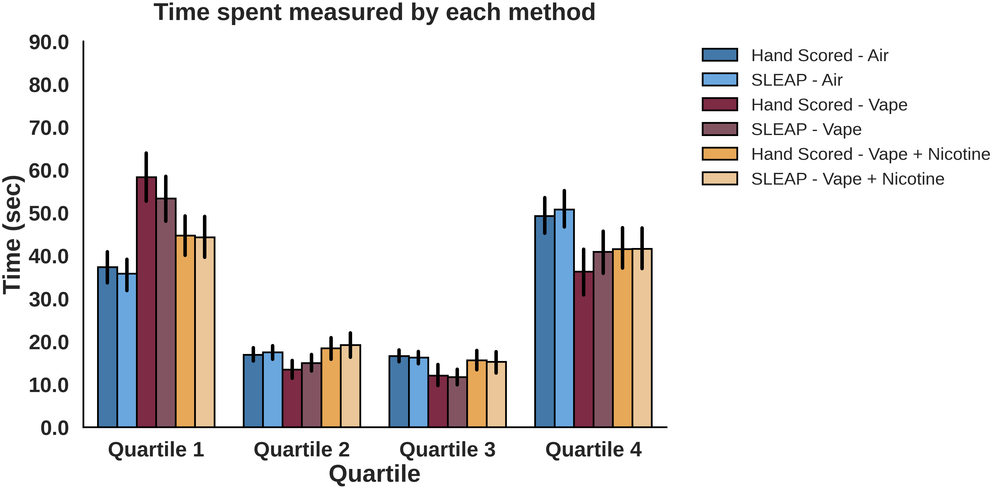

In [ ]:
sheet = gc.open('8_Example_Datasheet').worksheet("Comparisons Formatted")
df = get_as_dataframe(sheet).dropna(0, 'all').dropna(1, 'all')
df1 = df[df.Group.notna()]
df1 = df1[df1.Day != '3']
df1['Time'] = pd.to_numeric(df1['Time'], errors='coerce')
# pd.DataFrame.from_records(df1)

s = 10 #The size of the figure
plt.figure(figsize = (3*s,2*s))
plt.ylim(0,90)

palette={'Hand Scored - Air':'#3279ba','Hand Scored - Water':'#8C1D40','Hand Scored - Water + Nicotine':'#ffab40',
         'SLEAP - Air':'#57a8f2','SLEAP - Water':'#8a4c5f','SLEAP - Water + Nicotine':'#f7c78b'}

hue_order = ['Hand Scored - Air', 'SLEAP - Air', 'Hand Scored - Water', 'SLEAP - Water',
             'Hand Scored - Water + Nicotine','SLEAP - Water + Nicotine']
# Create the bar plot using the 'Group' column as x-axis, 'Q1' column as y-axis, and 'Color' column for colors
ax = sns.barplot(x=df1.Quadrant, y= df1.Time, data=df1, hue=df1.Grouping, dodge=True, palette=palette, errwidth = s,
                 linewidth=s/2, edgecolor='black', hue_order = hue_order, errorbar=('ci', 69), errcolor = 'black')

# Adjust Legend
if(ax.get_legend() != None):
  legend_labels = ['Hand Scored - Air', 'SLEAP - Air', 'Hand Scored - Vape', 'SLEAP - Vape',
             'Hand Scored - Vape + Nicotine','SLEAP - Vape + Nicotine']
  leg = plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0, markerscale = 10*s, prop={'size':5*s})
  for t, l in zip(leg.texts, legend_labels):
      t.set_text(l)

# Adjust Ticks
ax.set_xticklabels(['', 'Quartile 1','Quartile 2','Quartile 3', 'Quartile 4'],fontsize=12, fontweight='bold')

#Adjust Gridlines
sns.despine(right=True)
ax.spines['left'].set_linewidth(s/2)
ax.spines['bottom'].set_linewidth(s/2)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.grid(False)
ax.set_yticklabels(ax.get_yticks(),fontsize=12, fontweight='bold')
ax.tick_params(pad = 4*s, labelsize = 6*s)
loc = plticker.MultipleLocator(base=1.0) # this locator puts ticks at regular intervals
ax.xaxis.set_major_locator(loc)

# sns.stripplot(x=df1.Quadrant, y= df1.Time, data=df1, hue=df1.Grouping, dodge=True, color = '#e0e0e0',
#                  hue_order = hue_order, jitter=True, size=s, legend = False)

#Adjust Labels/Titles  Initiation  Response  Collection
plt.ylabel('Time (sec)',fontsize=7*s,  labelpad = 1*s, fontweight = 'bold' )
plt.xlabel('Quartile',fontsize=7*s,  labelpad = 1*s, fontweight = 'bold' )
plt.title('Time spent measured by each method', fontsize=7*s, fontweight = 'bold', y=1.05)

# plt.savefig('Time in each Q Compared.svg', format='svg', bbox_inches='tight')
# files.download(f'Time in each Q Compared.svg')

<ipython-input-22-cf1a8aa170d7>:2: FutureWarning: In a future version of pandas all arguments of DataFrame.dropna will be keyword-only.
  df = get_as_dataframe(sheet).dropna(0, 'all').dropna(1, 'all').drop(columns = ['File', 'HumanTimeQ1', 'HumanTimeQ2', 'HumanTimeQ3', 'HumanTimeQ4',
<ipython-input-22-cf1a8aa170d7>:24: FutureWarning: 

The `errcolor` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'color': 'black'}` instead.

  ax=sns.barplot(x=df1.Quartile,y=df1.TimeDiff,data=df1, hue=df1.Group,palette=palette, errwidth = s/1.5,
<ipython-input-22-cf1a8aa170d7>:24: FutureWarning: 

The `errwidth` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'linewidth': 6.666666666666667}` instead.

  ax=sns.barplot(x=df1.Quartile,y=df1.TimeDiff,data=df1, hue=df1.Group,palette=palette, errwidth = s/1.5,
<ipython-input-22-cf1a8aa170d7>:37: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['','Quartile 1','Q

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

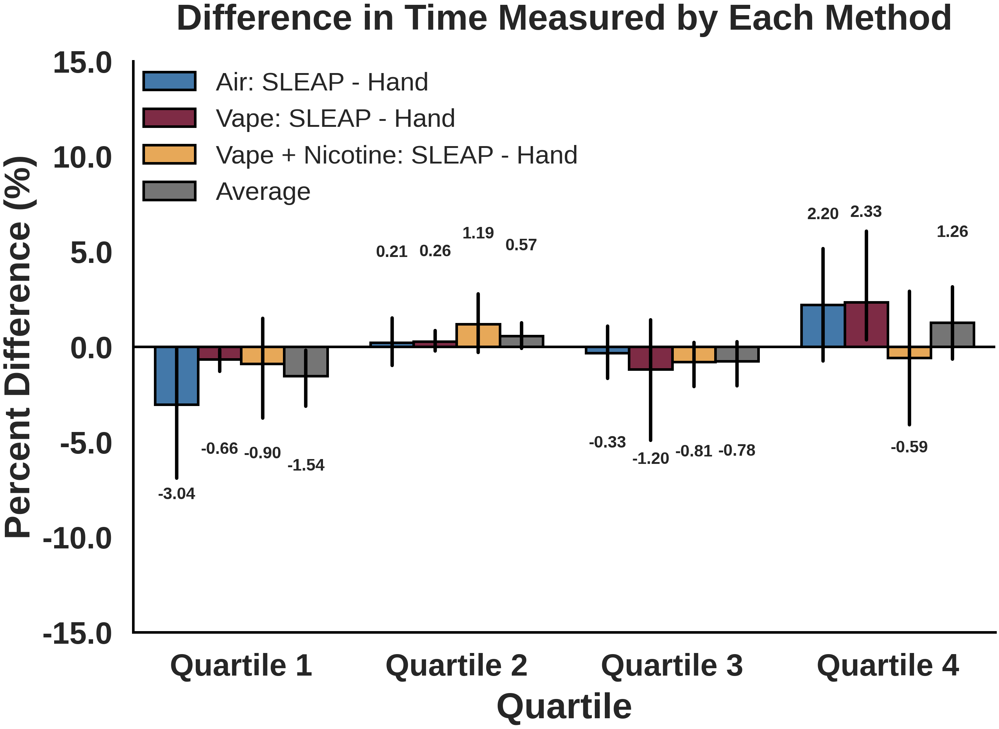

In [ ]:
sheet = gc.open('8_Example_Datasheet').worksheet("Comparisons")
df = get_as_dataframe(sheet).dropna(0, 'all').dropna(1, 'all').drop(columns = ['File', 'HumanTimeQ1', 'HumanTimeQ2', 'HumanTimeQ3', 'HumanTimeQ4',
                                                                               'SleapTimeQ1', 'SleapTimeQ2', 'SleapTimeQ3', 'SleapTimeQ4',
                                                                               'CalcTimeDiffQ1', 'CalcTimeDiffQ2', 'CalcTimeDiffQ3', 'CalcTimeDiffQ4',
                                                                               'Distance Q1', 'Distance Q2', 'Distance Q3', 'Distance Q4',
                                                                               'TotalDistance', 'CumulativeChange', 'TotalDistanceAsNum'])
df = df[df.Day != '3']
df.rename(columns=lambda x: x.replace('TimeDiff', ''), inplace=True)
df1 = df.melt(id_vars=['Day', 'Group'], var_name = 'Quartile', value_name = 'TimeDiff')
df1['Group'] = df1['Group'].replace({0: 'G0', 24: 'G24'})
df1 = df1[pd.to_numeric(df1['TimeDiff'], errors='coerce').notnull()]
df_copy = df1.copy()
df_copy['Group'] = 'Average'
df1 = pd.concat([df1, df_copy], ignore_index=True)
# pd.DataFrame.from_records(df1)

s = 10 #The size of the figure
plt.figure(figsize = (3*s,2*s))
palette={'Control':'#3279ba','G0':'#8C1D40',
         'G24':'#ffab40','Average':'#757575'}

hue_order = ['Control', 'G0', 'G24', 'Average']

ax=sns.barplot(x=df1.Quartile,y=df1.TimeDiff,data=df1, hue=df1.Group,palette=palette, errwidth = s/1.5,
               linewidth=s/2,  hue_order = hue_order, edgecolor='black',errorbar=('ci', 95), errcolor = 'black')

plt.ylim(-15,15)

# Adjust Legend
if(ax.get_legend() != None):
  legend_labels = ['Air: SLEAP - Hand','Vape: SLEAP - Hand', 'Vape + Nicotine: SLEAP - Hand']
  leg = plt.legend( loc='upper left', borderaxespad=0, markerscale = 10*s, prop={'size':5*s})
  for t, l in zip(leg.texts, legend_labels):
      t.set_text(l)

# Adjust Ticks
ax.set_xticklabels(['','Quartile 1','Quartile 2','Quartile 3', 'Quartile 4'],fontsize=12, fontweight='bold')
ax.axhline(y=0, linewidth=s/2, color='black')
#Adjust Gridlines
sns.despine(right=True)
ax.spines['left'].set_linewidth(s/2)
ax.spines['bottom'].set_linewidth(s/2)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.grid(False)
ax.set_yticklabels(ax.get_yticks(),fontsize=12, fontweight='bold')
ax.tick_params(pad = 4*s, labelsize = 6*s)
loc = plticker.MultipleLocator(base=1.0) # this locator puts ticks at regular intervals
ax.xaxis.set_major_locator(loc)

# Add values above bars
for i in ax.containers:
    ax.bar_label(i, fmt='%.2f', fontsize=s * 3.2, padding=s * 16, fontweight = 'bold')

#Adjust Labels/Titles  Initiation  Response  Collection
plt.ylabel('Percent Difference (%)',fontsize=7*s, labelpad = 1*s, fontweight='bold')
plt.xlabel('Quartile', fontsize=7*s, labelpad = 2*s, fontweight='bold')
plt.title('Difference in Time Measured by Each Method', fontsize=7*s, fontweight = 'bold', y=1.05)

plt.savefig('Difference.svg', format='svg', bbox_inches='tight')
files.download(f'Difference.svg')

##🟣  Plot time or distance spent over days in Q4

<ipython-input-21-36c4d618b7e3>:2: FutureWarning: In a future version of pandas all arguments of DataFrame.dropna will be keyword-only.
  df = get_as_dataframe(sheet).dropna(0, 'all').dropna(1, 'all')
<ipython-input-21-36c4d618b7e3>:57: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(['0', '1','2','3','4','5','6','7','8','9','10','11','12','13','14','15'],fontsize=12, fontweight='bold');
<ipython-input-21-36c4d618b7e3>:58: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticks(),fontsize=12, fontweight='bold');


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

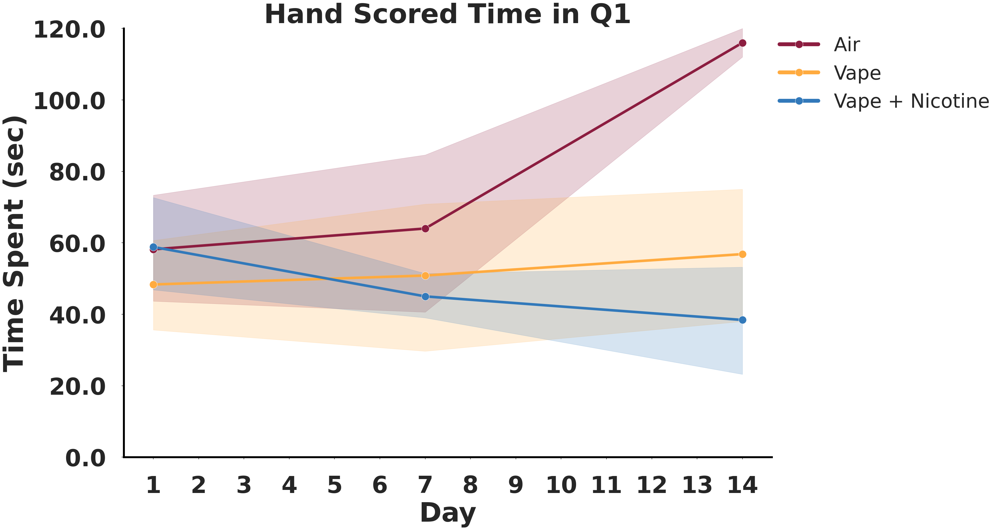

In [ ]:
sheet = gc.open('8_Example_Datasheet').worksheet("Comparisons Formatted")
df = get_as_dataframe(sheet).dropna(0, 'all').dropna(1, 'all')
df1 = df[df.Group.notna()]
df1 = df1[df1.Day.notna()]
# df1 = df1[df1.ScoreType == 'SLEAP']
df1 = df1[df1.ScoreType == 'Hand Scored']
df1 = df1[df1.Quadrant == 'Q1']
df1 = df1[df1.Day != 2]
df1 = df1[df1.Day != 3]
df1 = df1[df1.Day != 4]
df1 = df1[df1.Day != 5]
df1 = df1[df1.Day != 6]
df1 = df1[df1.Day != 8]
df1 = df1[df1.Day != 9]
df1 = df1[df1.Day != 10]
df1 = df1[df1.Day != 11]
df1 = df1[df1.Day != 12]
df1 = df1[df1.Day != 13]

df1 = df1[df1.Time.notna()]
df1 = df1[df1.Day.notna()]
df1 = df1[df1.Group.notna()]
df1 = df1[df1.Subject.notna()]
df1['Time'] = pd.to_numeric(df1['Time'], errors='coerce')
df1['Distance'] = pd.to_numeric(df1['Distance'], errors='coerce')
df1['Group'] = df1['Group'].astype(str)
df1['Subject'] = df1['Subject'].astype(str)
df1.reset_index(drop=True, inplace=True)

# pd.DataFrame.from_records(df1)

s = 10 #The size of the figure
plt.figure(figsize = (3*s,2*s))
plt.ylim(0,120)
palette={'Air':'#3279ba','Water':'#8C1D40','Water + Nicotine':'#ffab40'}
hue_order = ['Air', 'Water', 'Water + Nicotine']

ax=sns.lineplot(x=df1.Day,y=df1.Time,data=df1,hue=df1.Group,palette=palette,
                marker = 'o', linewidth=s/1.5, markersize=2*s, errorbar=('ci', 68))

# Adjust Legend
if(ax.get_legend() != None):
  legend_labels = ['Air', 'Vape', 'Vape + Nicotine']
  leg = plt.legend(bbox_to_anchor=(1, 1),loc='upper left', borderaxespad=0, markerscale = s/10, prop={'size':5*s})
  leg.get_lines()[0].set_linewidth(s)
  leg.get_lines()[1].set_linewidth(s)
  leg.get_lines()[2].set_linewidth(s)
  for t, l in zip(leg.texts, legend_labels):
      t.set_text(l)

sns.despine(right=True)
ax.spines['left'].set_linewidth(s/2)
ax.spines['bottom'].set_linewidth(s/2)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.grid(False)
ax.set_xticklabels(['0', '1','2','3','4','5','6','7','8','9','10','11','12','13','14','15'],fontsize=12, fontweight='bold');
ax.set_yticklabels(ax.get_yticks(),fontsize=12, fontweight='bold');
ax.tick_params(pad = 4*s, labelsize = 6*s)
loc = plticker.MultipleLocator(base=1.0) # this locator puts ticks at regular intervals
ax.xaxis.set_major_locator(loc)

plt.ylabel('Time Spent (sec)',fontsize=7*s, labelpad = 1*s, fontweight='bold')
plt.xlabel('Day', fontsize=7*s, labelpad = 1*s, fontweight='bold')
if df1.ScoreType[0] == 'Hand Scored':
  plt.title(f'Hand Scored Time in {df1.Quadrant[0]}', fontsize=7*s, fontweight = 'bold' )
else:
  plt.title(f'SLEAP Scored Time in {df1.Quadrant[0]}', fontsize=7*s, fontweight = 'bold' )

plt.savefig('Q4Time.svg', format='svg', bbox_inches='tight')
files.download(f'Q4Time.svg')

## 🟣 Plot time or distance binned every 5 days in Q4

<ipython-input-105-0cebabb8cb17>:2: FutureWarning: In a future version of pandas all arguments of DataFrame.dropna will be keyword-only.
  df = get_as_dataframe(sheet).dropna(0, 'all').dropna(1, 'all')
/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:#000000'` for same effect.
  warnings.warn(msg, FutureWarning)
<ipython-input-105-0cebabb8cb17>:59: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(ax.get_yticks(),fontsize=12, fontweight='bold');


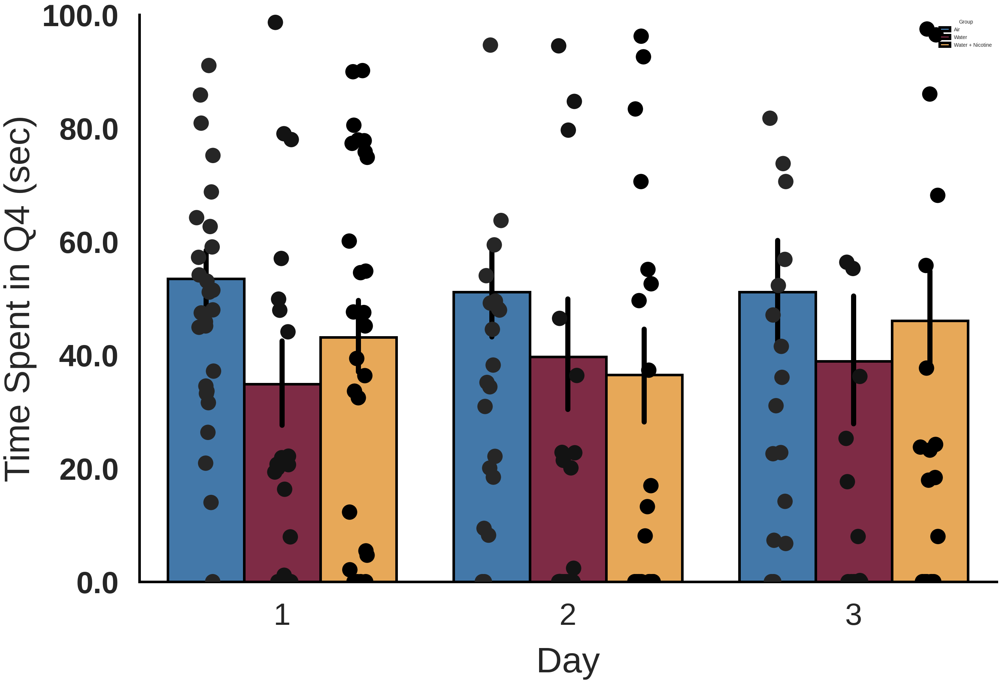

In [ ]:
sheet = gc.open('8_Example_Datasheet').worksheet("Comparisons Formatted")
df = get_as_dataframe(sheet).dropna(0, 'all').dropna(1, 'all')
df1 = df[df.Group.notna()]
df1 = df1[df1.Day.notna()]
df1 = df1[df1.ScoreType == 'SLEAP']
df1 = df1[df1.Quadrant == 'Q4']
df1["Bins"] = (df1['Day']-1)/5 + 1
df1["Bins"] = df1["Bins"].astype('int')

df1['Distance'] = pd.to_numeric(df1['Distance'], errors='coerce')
df1['Time'] = pd.to_numeric(df1['Time'], errors='coerce')
df1 = df1[df1.Time.notna()]
df1 = df1[df1.Distance.notna()]
df1 = df1[df1.Day.notna()]
df1 = df1[df1.Group.notna()]
df1 = df1[df1.Subject.notna()]
df1['Time'] = pd.to_numeric(df1['Time'], errors='coerce')
df1['Distance'] = pd.to_numeric(df1['Distance'], errors='coerce')
df1['Group'] = df1['Group'].astype(str)
df1['Subject'] = df1['Subject'].astype(str)


# print(df1)

s = 10 #The size of the figure
plt.figure(figsize = (3*s,2*s))
plt.ylim(0,100)
palette={'Air':'#3279ba','Water':'#8C1D40','Water + Nicotine':'#ffab40'}
hue_order = ['Air', 'Water', 'Water + Nicotine']

# ax=sns.lineplot(x=df1.Bins,y=df1.Time,data=df1,hue=df1.Group,palette=palette,
#                 marker = 'o', linewidth=s/2, markersize=2*s, errorbar=('ci', 68))

ax = sns.barplot(x=df1.Bins, y= df1.Time, data=df1, hue=df1.Group, dodge=True, palette=palette, errwidth = s,
                 linewidth=s/2, edgecolor='black', hue_order = hue_order, errorbar=('ci', 69), errcolor = 'black')
sns.stripplot(x=df1.Bins, y= df1.Time, data=df1, hue=df1.Group, dodge=True, color = '#000000',
                 hue_order = hue_order, jitter=True, size=s*3, legend = False)

plt.ylabel('Time Spent in Q4 (sec)',fontsize=7*s,  labelpad = 1*s)
plt.xlabel('Day', fontsize=7*s, labelpad = 3*s)

# Adjust Legend
# if(ax.get_legend() != None):
#   legend_labels = ['Air', 'Vape', 'Vape + Nicotine']
#   leg = plt.legend(bbox_to_anchor=(1, 1.4),loc='upper right', borderaxespad=0, markerscale = 10*s, prop={'size':5*s})
#   leg.get_lines()[0].set_linewidth(s)
#   leg.get_lines()[1].set_linewidth(s)
#   leg.get_lines()[2].set_linewidth(s)
#   for t, l in zip(leg.texts, legend_labels):
#       t.set_text(l)

sns.despine(right=True)
ax.spines['left'].set_linewidth(s/2)
ax.spines['bottom'].set_linewidth(s/2)
ax.spines['left'].set_color('black')
ax.spines['bottom'].set_color('black')
plt.grid(False)
# ax.set_xticklabels(['Day 1-5','Day 6-10','Day 11-14'],fontsize=12, fontweight='bold');
ax.set_yticklabels(ax.get_yticks(),fontsize=12, fontweight='bold');
ax.tick_params(pad = 4*s, labelsize = 6*s)
loc = plticker.MultipleLocator(base=1.0) # this locator puts ticks at regular intervals
ax.xaxis.set_major_locator(loc)